In [1]:
import nannyml as nml
from IPython.display import display

reference_df = nml.load_synthetic_binary_classification_dataset()[0]
analysis_df = nml.load_synthetic_binary_classification_dataset()[1]
display(reference_df.head())

,distance_from_office,salary_range,gas_price_per_litre,public_transportation_cost,wfh_prev_workday,workday,tenure,identifier,work_home_actual,timestamp,y_pred_proba,period,y_pred
0,5.962247,40K - 60K €,2.119485,8.568058,False,Friday,0.212653,0,1,2014-05-09 22:27:20,0.99,reference,1
1,0.535872,40K - 60K €,2.357199,5.425382,True,Tuesday,4.927549,1,0,2014-05-09 22:59:32,0.07,reference,0
2,1.969519,40K - 60K €,2.366849,8.247158,False,Monday,0.520817,2,1,2014-05-09 23:48:25,1.00,reference,1
3,2.530410,20K - 40K €,2.318722,7.944251,False,Tuesday,0.453649,3,1,2014-05-10 01:12:09,0.98,reference,1
4,2.253635,60K+ €,2.221265,8.884478,True,Thursday,5.695263,4,1,2014-05-10 02:21:34,0.99,reference,1


In [2]:
print(reference_df.head().to_markdown(tablefmt="grid"))

+----+------------------------+----------------+-----------------------+------------------------------+--------------------+-----------+----------+--------------+--------------------+---------------------+----------------+-----------+----------+
|    |   distance_from_office | salary_range   |   gas_price_per_litre |   public_transportation_cost | wfh_prev_workday   | workday   |   tenure |   identifier |   work_home_actual | timestamp           |   y_pred_proba | period    |   y_pred |
+====+========================+================+=======================+==============================+====================+===========+==========+==============+====================+=====================+================+===========+==========+
|  0 |               5.96225  | 40K - 60K €    |               2.11948 |                      8.56806 | False              | Friday    | 0.212653 |            0 |                  1 | 2014-05-09 22:27:20 |           0.99 | reference |        1 |
+----+----------

In [3]:
from nannyml.drift.model_inputs.univariate.distance import DistanceDriftCalculator

feature_column_names = [
    col for col in reference_df.columns if col not in [
    'timestamp', 'y_pred_proba', 'period', 'y_pred', 'work_home_actual', 'identifier'
]]
calc = DistanceDriftCalculator(
    feature_column_names=feature_column_names,
    timestamp_column_name='timestamp',
    metrics=['jensen_shannon']
)

In [4]:
calc.fit(reference_df)
results = calc.calculate(analysis_df)
# display(results.filter(period='analysis').to_df().iloc[:, :9])
display(results.data.loc[results.data.period=='analysis'].iloc[:,:9])

,key,chunk_index,start_index,end_index,start_date,end_date,distance_from_office_jensen_shannon,distance_from_office_jensen_shannon_alert,distance_from_office_jensen_shannon_upper_threshold
10,[0:4999],0,0,4999,2017-08-31 04:20:00,2018-01-02 00:45:44,0.017968,False,0.1
11,[5000:9999],1,5000,9999,2018-01-02 01:13:11,2018-05-01 13:10:10,0.015387,False,0.1
12,[10000:14999],2,10000,14999,2018-05-01 14:25:25,2018-09-01 15:40:40,0.014454,False,0.1
13,[15000:19999],3,15000,19999,2018-09-01 16:19:07,2018-12-31 10:11:21,0.022912,False,0.1
14,[20000:24999],4,20000,24999,2018-12-31 10:38:45,2019-04-30 11:01:30,0.018943,False,0.1
15,[25000:29999],5,25000,29999,2019-04-30 11:02:00,2019-09-01 00:24:27,0.382750,True,0.1
16,[30000:34999],6,30000,34999,2019-09-01 00:28:54,2019-12-31 09:09:12,0.379010,True,0.1
17,[35000:39999],7,35000,39999,2019-12-31 10:07:15,2020-04-30 11:46:53,0.382238,True,0.1
18,[40000:44999],8,40000,44999,2020-04-30 12:04:32,2020-09-01 02:46:02,0.384508,True,0.1
19,[45000:49999],9,45000,49999,2020-09-01 02:46:13,2021-01-01 04:29:32,0.384253,True,0.1


In [5]:
# print(results.filter(period='analysis').to_df().iloc[:, :9].to_markdown(tablefmt="grid"))
print(results.data.loc[results.data.period=='analysis'].iloc[:,:9].to_markdown(tablefmt="grid"))

+----+---------------+---------------+---------------+-------------+---------------------+---------------------+---------------------------------------+---------------------------------------------+-------------------------------------------------------+
|    | key           |   chunk_index |   start_index |   end_index | start_date          | end_date            |   distance_from_office_jensen_shannon | distance_from_office_jensen_shannon_alert   |   distance_from_office_jensen_shannon_upper_threshold |
+====+===============+===============+===============+=============+=====================+=====================+=======================================+=============================================+=======================================================+
| 10 | [0:4999]      |             0 |             0 |        4999 | 2017-08-31 04:20:00 | 2018-01-02 00:45:44 |                             0.017968  | False                                       |                                     

In [6]:
# display(results.filter(period='reference').to_df().iloc[:, :9])
display(results.data.loc[results.data.period=='reference'].iloc[:,:9])

,key,chunk_index,start_index,end_index,start_date,end_date,distance_from_office_jensen_shannon,distance_from_office_jensen_shannon_alert,distance_from_office_jensen_shannon_upper_threshold
0,[0:4999],0,0,4999,2014-05-09 22:27:20,2014-09-09 08:18:27,0.020213,False,0.1
1,[5000:9999],1,5000,9999,2014-09-09 09:13:35,2015-01-09 00:02:51,0.014843,False,0.1
2,[10000:14999],2,10000,14999,2015-01-09 00:04:43,2015-05-09 15:54:26,0.023891,False,0.1
3,[15000:19999],3,15000,19999,2015-05-09 16:02:08,2015-09-07 07:14:37,0.014028,False,0.1
4,[20000:24999],4,20000,24999,2015-09-07 07:27:47,2016-01-08 16:02:05,0.011398,False,0.1
5,[25000:29999],5,25000,29999,2016-01-08 17:22:00,2016-05-09 11:09:39,0.019696,False,0.1
6,[30000:34999],6,30000,34999,2016-05-09 11:19:36,2016-09-04 03:30:35,0.013510,False,0.1
7,[35000:39999],7,35000,39999,2016-09-04 04:09:35,2017-01-03 18:48:21,0.022226,False,0.1
8,[40000:44999],8,40000,44999,2017-01-03 19:00:51,2017-05-03 02:34:24,0.019473,False,0.1
9,[45000:49999],9,45000,49999,2017-05-03 02:49:38,2017-08-31 03:10:29,0.020819,False,0.1


In [7]:
# print(results.filter(period='reference').to_df().iloc[:, :9].to_markdown(tablefmt="grid"))
print(results.data.loc[results.data.period=='reference'].iloc[:,:9].to_markdown(tablefmt="grid"))

+----+---------------+---------------+---------------+-------------+---------------------+---------------------+---------------------------------------+---------------------------------------------+-------------------------------------------------------+
|    | key           |   chunk_index |   start_index |   end_index | start_date          | end_date            |   distance_from_office_jensen_shannon | distance_from_office_jensen_shannon_alert   |   distance_from_office_jensen_shannon_upper_threshold |
+====+===============+===============+===============+=============+=====================+=====================+=======================================+=============================================+=======================================================+
|  0 | [0:4999]      |             0 |             0 |        4999 | 2014-05-09 22:27:20 | 2014-09-09 08:18:27 |                             0.0202127 | False                                       |                                     

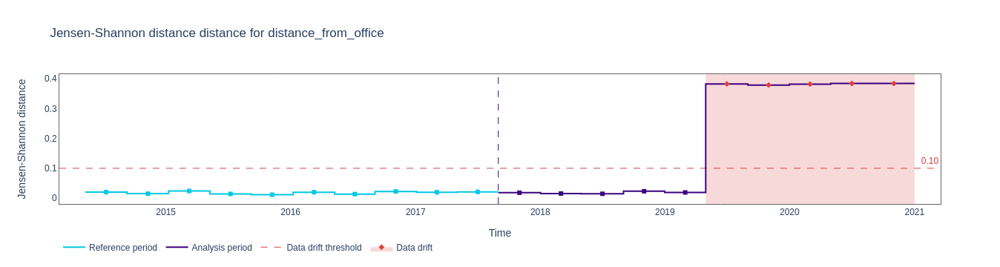

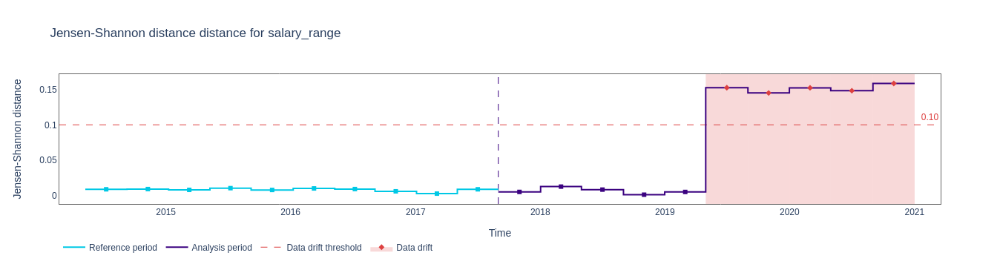

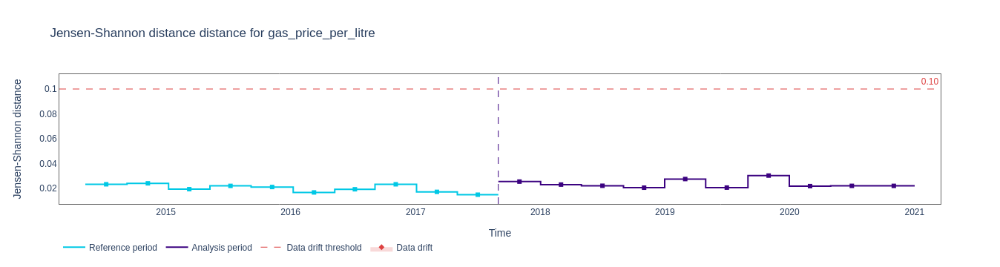

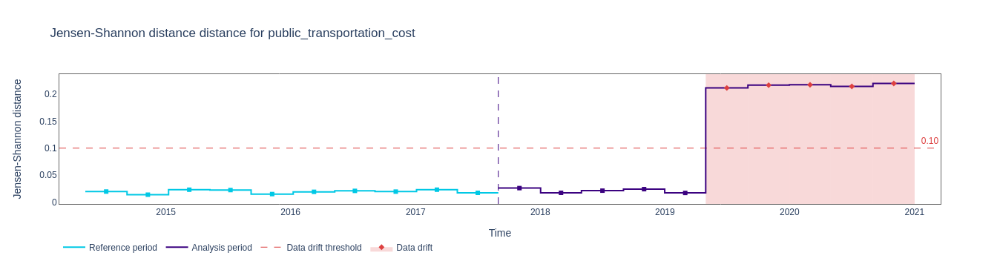

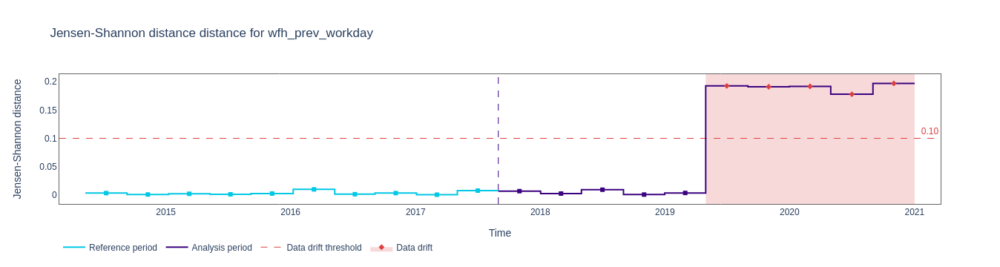

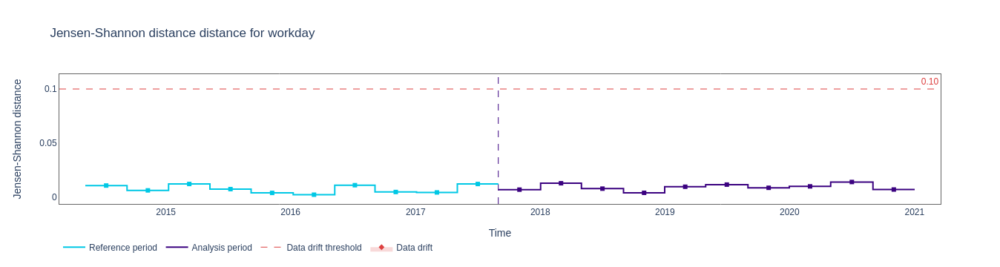

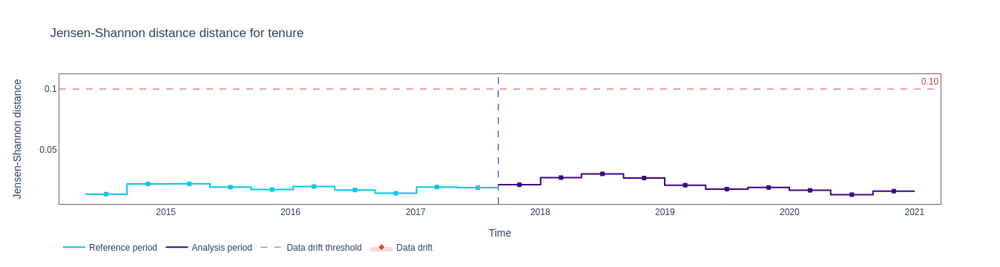

In [8]:
for feature in calc.feature_column_names:
    drift_fig = results.plot(
        kind='feature_drift',
        metric='jensen_shannon',
        feature_column_name=feature,
        plot_reference=True
    )
    drift_fig.show()

In [9]:
for feature in calc.feature_column_names:
    drift_fig = results.plot(
        kind='feature_drift',
        metric='jensen_shannon',
        feature_column_name=feature,
        plot_reference=True
    )
    drift_fig.write_image(f'../_static/drift-guide-univariate-distance-{feature}.svg')

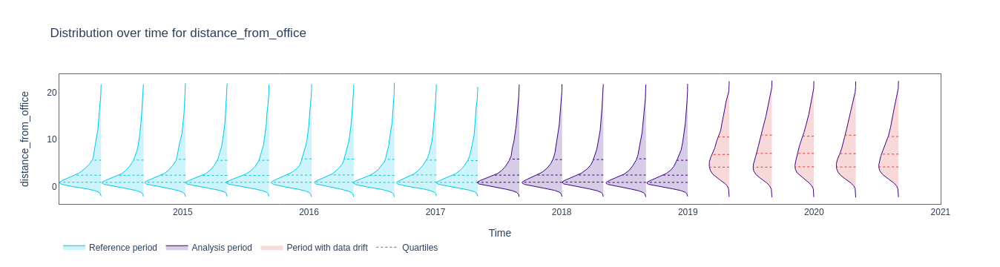

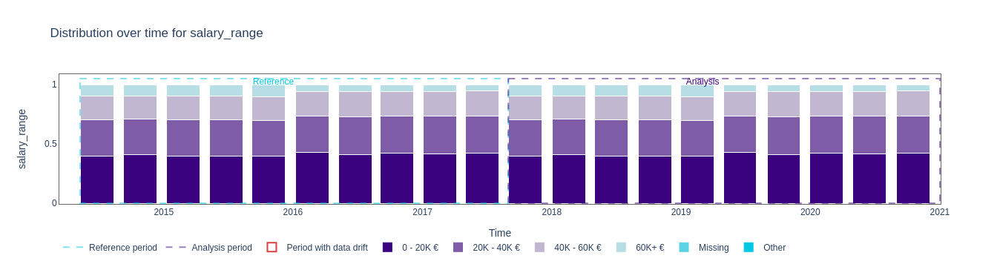

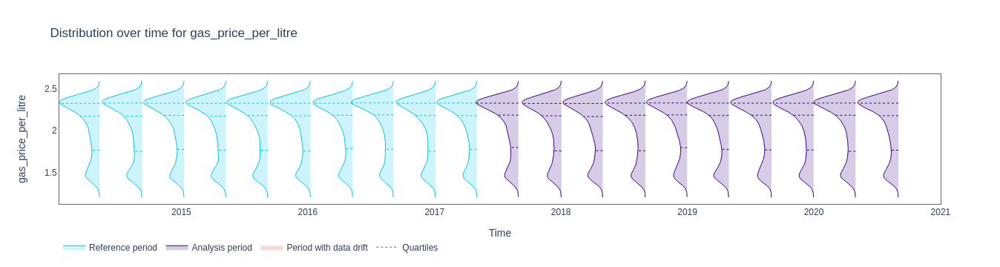

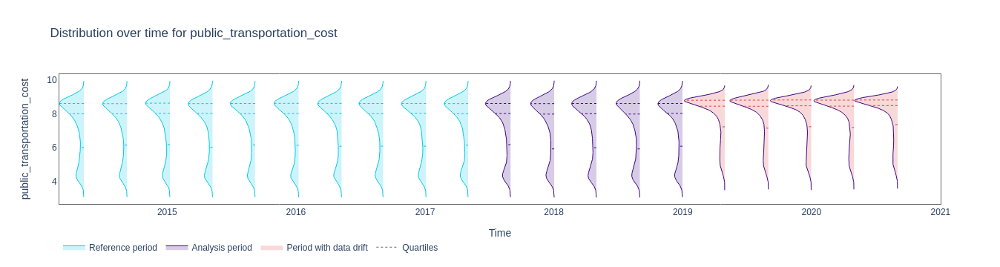

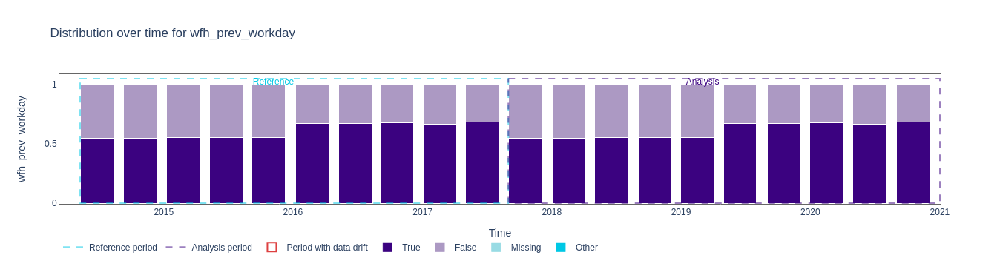

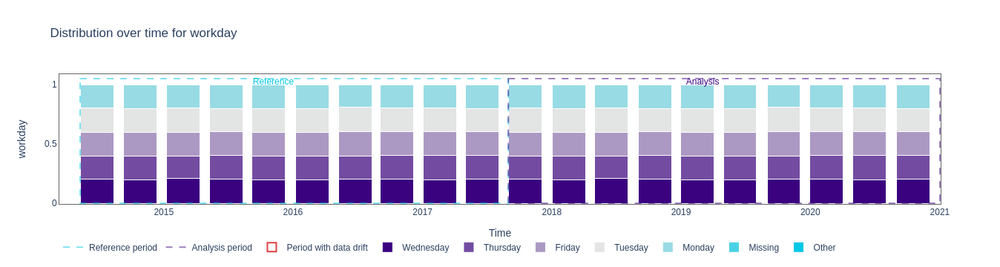

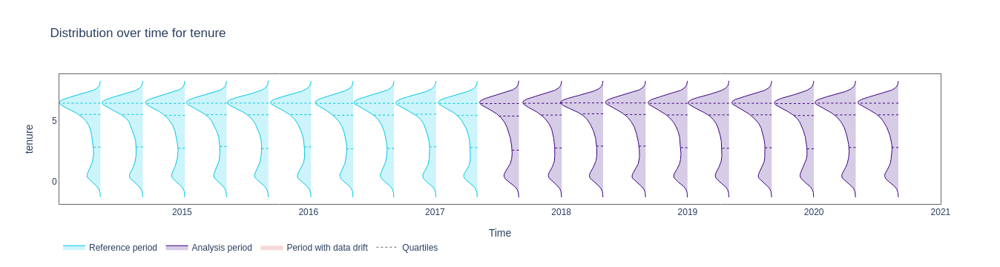

In [10]:
for feature in calc.feature_column_names:
    figure = results.plot(
        kind='feature_distribution',
        feature_column_name=feature,
        metric='jensen_shannon',
        plot_reference=True
    )
    figure.show()

In [11]:
try:
    ranker = nml.Ranker.by('alert_count')
    ranked_features = ranker.rank(results, only_drifting = False)
    display(ranked_features)
except expression:
    print('Ranker needs fixing')

KeyError: "None of [Index(['distance_from_office_alert', 'salary_range_alert',\n       'gas_price_per_litre_alert', 'public_transportation_cost_alert',\n       'wfh_prev_workday_alert', 'workday_alert', 'tenure_alert'],\n      dtype='object')] are in the [columns]"

In [ ]:
try:
    print(ranked_features.to_markdown(tablefmt="grid"))
except expression:
    print('Ranker needs fixing')

+----+----------------------------+--------------------+--------+
|    | feature                    |   number_of_alerts |   rank |
+====+============================+====================+========+
|  0 | distance_from_office       |                  5 |      1 |
+----+----------------------------+--------------------+--------+
|  1 | salary_range               |                  5 |      2 |
+----+----------------------------+--------------------+--------+
|  2 | public_transportation_cost |                  5 |      3 |
+----+----------------------------+--------------------+--------+
|  3 | wfh_prev_workday           |                  5 |      4 |
+----+----------------------------+--------------------+--------+
|  4 | tenure                     |                  2 |      5 |
+----+----------------------------+--------------------+--------+
|  5 | gas_price_per_litre        |                  0 |      6 |
+----+----------------------------+--------------------+--------+
|  6 | wor